<a href="https://colab.research.google.com/github/TheNotoriousXxX/BusReservationSystem/blob/terminator2.0/YOLONAS_Object_Detection_Images_Videos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**🚨 Before Running the Script, Please make sure that you have selected the Run Time as GPU**

#**Step 01: Install the Required Packages**

In [8]:
%%capture
!pip install super-gradients
!pip install imutils
!pip install roboflow
!pip install pytube --upgrade

In [6]:
!pip install torchinfo

#**🚨Restart the Run Time**

#**Step 02: Import the Required Libraries**

In [9]:
from super_gradients.training import models


The console stream is logged into /root/sg_logs/console.log


[2023-08-20 10:42:23] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it
[2023-08-20 10:42:26] WARNING - __init__.py - Failed to import pytorch_quantization
[2023-08-20 10:42:35] INFO - utils.py - NumExpr defaulting to 2 threads.
/usr/local/lib/python3.10/dist-packages/_distutils_hack/__init__.py:33: UserWarning: Setuptools is replacing distutils.
  warnings.warn("Setuptools is replacing distutils.")
[2023-08-20 10:42:36] WARNING - calibrator.py - Failed to import pytorch_quantization
[2023-08-20 10:42:36] WARNING - export.py - Failed to import pytorch_quantization
[2023-08-20 10:42:36] WARNING - selective_quantization_utils.py - Failed to import pytorch_quantization
[2023-08-20 10:42:36] WARNING - env_sanity_check.py - Failed to verify installed packages: boto3 required but not found
[2023-08-20 10:42:36] WARNING - env_sanity_check.py - Failed to verify installed packages: deprecated required but not found
[20

In [13]:
from torchinfo import summary

#**Step 03: Instantiating a Pretrained Model**

In [10]:
yolo_nas_l = models.get("yolo_nas_l", pretrained_weights="coco")

[2023-08-20 10:42:43] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_l_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_l_coco.pth
100%|██████████| 256M/256M [00:04<00:00, 62.7MB/s]
[2023-08-20 10:42:48] INFO - checkpoint_utils.py - Successfully loaded pretrained weights for architecture yolo_nas_l


#**Step 04: Model Architecture**

In [14]:
summary(model=yolo_nas_l,
        input_size=(16, 3, 640, 640),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

Layer (type (var_name))                                           Input Shape          Output Shape         Param #              Trainable
YoloNAS_L (YoloNAS_L)                                             [16, 3, 640, 640]    [16, 8400, 4]        --                   True
├─NStageBackbone (backbone)                                       [16, 3, 640, 640]    [16, 96, 160, 160]   --                   True
│    └─YoloNASStem (stem)                                         [16, 3, 640, 640]    [16, 48, 320, 320]   --                   True
│    │    └─QARepVGGBlock (conv)                                  [16, 3, 640, 640]    [16, 48, 320, 320]   3,024                True
│    └─YoloNASStage (stage1)                                      [16, 48, 320, 320]   [16, 96, 160, 160]   --                   True
│    │    └─QARepVGGBlock (downsample)                            [16, 48, 320, 320]   [16, 96, 160, 160]   88,128               True
│    │    └─YoloNASCSPLayer (blocks)                     

#**Step 05: Inference with YOLONAS**

#**🖼️ Inference on an image**

#**A path to image file**

[2023-08-20 10:49:18] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


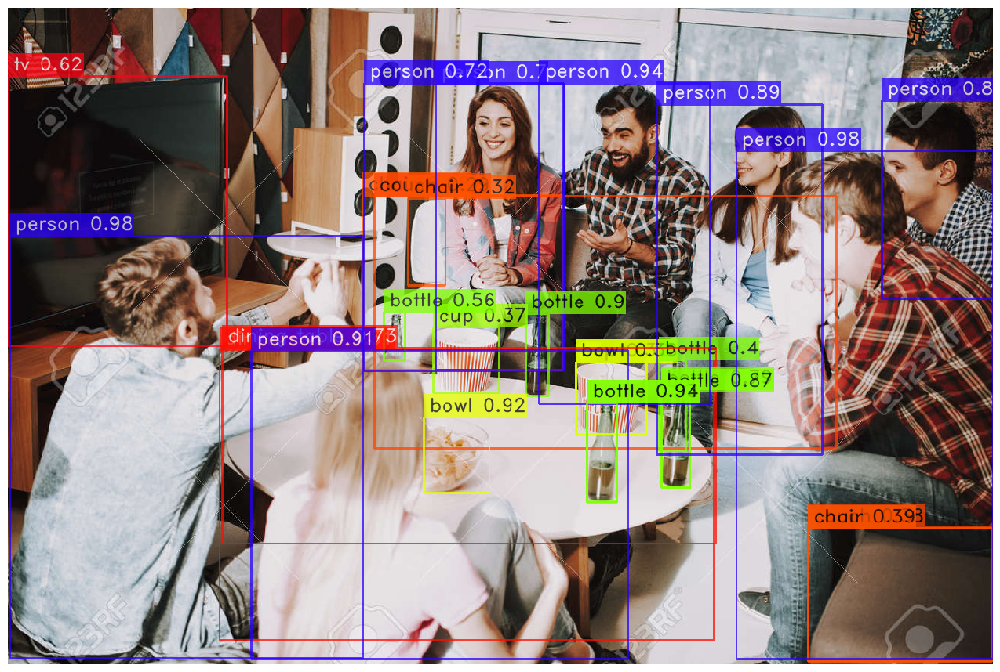

In [22]:
url = "https://previews.123rf.com/images/freeograph/freeograph2011/freeograph201100150/158301822-group-of-friends-gathering-around-table-at-home.jpg"
yolo_nas_l.predict(url, conf=0.25).show()

#**Upload an Image**

In [ ]:
!gdown "https://drive.google.com/uc?id=1q-sNrJfUi6PjvT8mFfEw1Cq4eCavdklK&confirm=t"

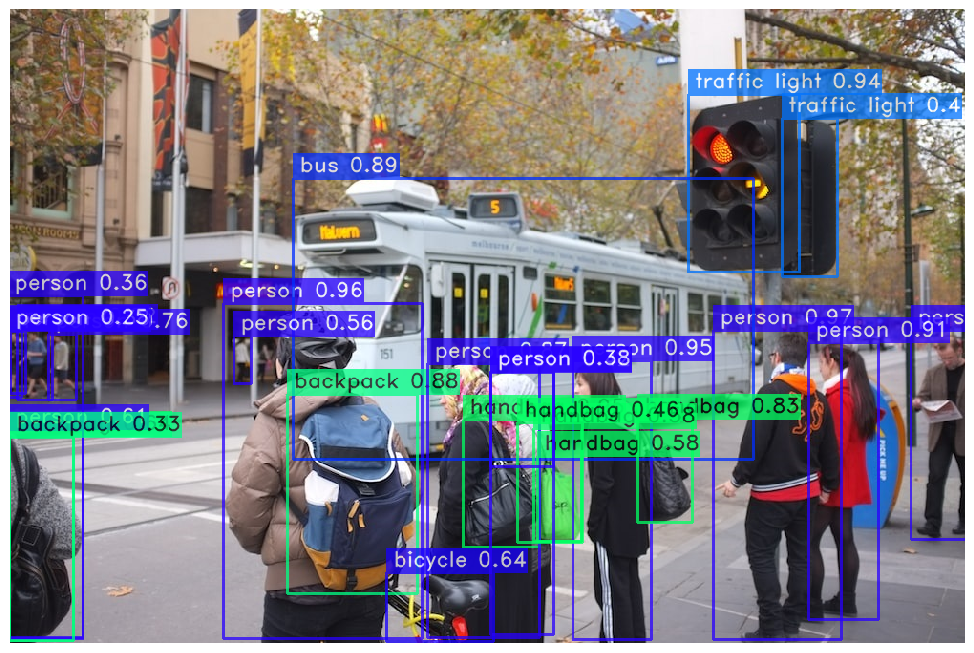

In [ ]:
image_path = '/content/image1.jpg'
yolo_nas_l.predict(image_path, conf=0.25).show()

#**🎥 Inference on Video 1**

In [16]:
!gdown "https://drive.google.com/uc?id=1hl_NNFciFwImmqplL3RkozpiIa8I38cd&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1hl_NNFciFwImmqplL3RkozpiIa8I38cd&confirm=t
To: /content/demo.mp4
100% 11.5M/11.5M [00:00<00:00, 25.0MB/s]


In [17]:
input_video_path = f"/content/demo.mp4"
output_video_path = "detections.mp4"

In [18]:
import torch
device = 'cuda' if torch.cuda.is_available() else "cpu"

In [19]:
yolo_nas_l.to(device).predict(input_video_path).save(output_video_path)

Predicting Video: 100%|██████████| 1314/1314 [00:31<00:00, 42.24it/s]


#**Display the Output Video**

In [20]:
!rm '/content/result_compressed.mp4'

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [21]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**🎥 Inference on Video 2**

In [ ]:
!gdown "https://drive.google.com/uc?id=115RBSjNQ_1zjvKFRsQK2zE8v8BIRrpdy&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=115RBSjNQ_1zjvKFRsQK2zE8v8BIRrpdy&confirm=t
To: /content/testwalk.mp4
100% 7.61M/7.61M [00:00<00:00, 27.8MB/s]


In [ ]:
input_video_path = f"/content/testwalk.mp4"
output_video_path = "detections2.mp4"

In [ ]:
import torch
device = 'cuda' if torch.cuda.is_available() else "cpu"

In [ ]:
yolo_nas_l.to(device).predict(input_video_path).save(output_video_path)

Predicting Video: 100%|██████████| 341/341 [00:16<00:00, 20.98it/s]


#**Display the Output Video**

In [ ]:
!rm '/content/result_compressed.mp4'

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections2.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)